In [2]:
pip install tensorflow

  Using cached tensorflow-2.19.0-cp311-cp311-macosx_12_0_arm64.whl.metadata (4.0 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl.metadata (4.4 kB)
  Using cached flatbuffers-25.2.10-py2.py3-none-any.whl.metadata (875 bytes)
  Using cached gast-0.6.0-py3-none-any.whl.metadata (1.3 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl.metadata (814 bytes)
  Using cached libclang-18.1.1-1-py2.py3-none-macosx_11_0_arm64.whl.metadata (5.2 kB)
  Using cached opt_einsum-3.4.0-py3-none-any.whl.metadata (6.3 kB)
  Using cached protobuf-5.29.4-cp38-abi3-macosx_10_9_universal2.whl.metadata (592 bytes)
  Using cached requests-2.32.3-py3-none-any.whl.metadata (4.6 kB)
  Using cached termcolor-3.0.1-py3-none-any.whl.metadata (6.1 kB)
  Using cached tensorboard-2.19.0-py3-none-any.whl.metadata (1.8 kB)
  Using cached keras-3.9.2-py3-none-any.whl.metadata (6.1 kB)
  Using cached numpy-2.1.3-cp311-cp311-macosx_14_0_arm64.whl.metadata (62 kB)
  Using cached h5py-3.13.0-cp311-cp311-macosx_11_0_

In [4]:
pip install matplotlib


  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached pyparsing-3.2.3-py3-none-any.whl.metadata (5.0 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.0/8.0 MB 478.5 kB/s eta 0:00:0000:0100:01
Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 734.7 kB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 733.4 kB/s eta 0:00:00a 0:00:01
Using cached pyparsing-3.2.3-py3-none-any.whl (111 kB)
Note: you may need to restart the kernel to use updated packages.


In [5]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, Flatten, Reshape

In [3]:
# Load MNIST dataset
(x_train, _), (x_test, _) = mnist.load_data()

# Normalize and reshape the data
x_train = np.expand_dims(x_train, axis=-1).astype('float32') / 255.0
x_test = np.expand_dims(x_test, axis=-1).astype('float32') / 255.0

# Set image dimensions
image_shape = (28, 28, 1)

In [5]:
# Encoder
input_img = Input(shape=image_shape)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
encoded = Conv2D(8, (3, 3), activation='relu', padding='same')(x)

# Decoder
x = Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(encoded)
x = Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2DTranspose(1, (3, 3), activation='sigmoid', padding='same')(x)

# Autoencoder model
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

In [9]:
# Train the autoencoder
autoencoder.fit(x_train, x_train,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_data=(x_test, x_test))

Epoch 1/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 106s 446ms/step - loss: 0.2210 - val_loss: 0.0623
Epoch 2/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 98s 417ms/step - loss: 0.0622 - val_loss: 0.0608
Epoch 3/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 109s 462ms/step - loss: 0.0608 - val_loss: 0.0600
Epoch 4/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 106s 452ms/step - loss: 0.0602 - val_loss: 0.0597
Epoch 5/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 103s 441ms/step - loss: 0.0598 - val_loss: 0.0594
Epoch 6/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 85s 364ms/step - loss: 0.0597 - val_loss: 0.0592
Epoch 7/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 86s 367ms/step - loss: 0.0595 - val_loss: 0.0590
Epoch 8/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 85s 362ms/step - loss: 0.0593 - val_loss: 0.0590
Epoch 9/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 90s 383ms/step - loss: 0.0592 - val_loss: 0.0588
Epoch 10/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 86s 367ms/step - loss: 0.0591 - val_loss: 0.0587
Epoch 11/50
235/235 ━━━━━━━━━━━━━━━━━━━━ 88s 373ms/step - loss: 0.0590 - val_loss: 0.0586
Epoch 12/50
235

313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step


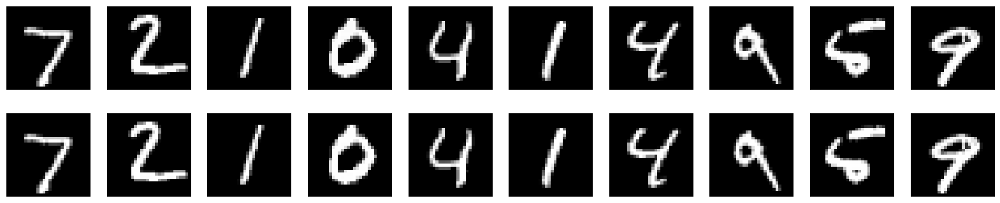

In [11]:
# Generate images from the test set
decoded_imgs = autoencoder.predict(x_test)

# Plot original and generated images
n = 10  # Number of images to display
plt.figure(figsize=(20, 4))
for i in range(n):
    # Display original
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_test[i].reshape(28, 28), cmap='gray')
    plt.axis('off')

    # Display reconstruction
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(decoded_imgs[i].reshape(28, 28), cmap='gray')
    plt.axis('off')
plt.show()

In [15]:
print(x_train)

[[[[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  ...

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]]


 [[[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  ...

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]]


 [[[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  ...

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.]
   [0.]
   [0.]
   ...
   [0.]
   [0.]
   [0.]]

  [[0.

In [7]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Define paths to your local train and test image datasets
train_dataset_dir = 'Dataset/'
test_dataset_dir = 'Dataset/'

# Set image size and batch size
img_size = (28, 28)  # Resize images to 28x28
batch_size = 32      # Batch size for training

# Load the train dataset
train_dataset = image_dataset_from_directory(
    train_dataset_dir,
    image_size=img_size,   # Resize images to 28x28
    batch_size=batch_size, # Number of images per batch
    label_mode=None,       # No labels since you didn't mention classification
    shuffle=True           # Shuffle the dataset for training
)

# Normalize the pixel values (scale from [0, 255] to [0, 1])
train_dataset = train_dataset.map(lambda x: x / 255.0)

# Load the test dataset
test_dataset = image_dataset_from_directory(
    test_dataset_dir,
    image_size=img_size,   # Resize images to 28x28
    batch_size=batch_size, # Number of images per batch
    label_mode=None,       # No labels
    shuffle=False          # Don't shuffle the test dataset
)

# Normalize the pixel values for the test dataset as well
test_dataset = test_dataset.map(lambda x: x / 255.0)

# Check the shape of the data for both datasets
for batch in train_dataset.take(1):
    print("Train batch shape:", batch.shape)

for batch in test_dataset.take(1):
    print("Test batch shape:", batch.shape)

Found 60 files.
Found 60 files.
Train batch shape: (32, 28, 28, 3)
Test batch shape: (32, 28, 28, 3)


2024-09-08 15:24:34.236733: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2024-09-08 15:24:34.335282: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [17]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, Concatenate, Add
from tensorflow.keras.models import Model

# Define image shape (e.g., 28x28 with 1 channel for grayscale images)
image_shape = (28, 28, 1)

# Encoder for the first input image
input_img1 = Input(shape=image_shape)
x1 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img1)
x1 = Conv2D(16, (3, 3), activation='relu', padding='same')(x1)
encoded1 = Conv2D(8, (3, 3), activation='relu', padding='same')(x1)

# Encoder for the second input image
input_img2 = Input(shape=image_shape)
x2 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img2)
x2 = Conv2D(16, (3, 3), activation='relu', padding='same')(x2)
encoded2 = Conv2D(8, (3, 3), activation='relu', padding='same')(x2)

# Combine the two feature maps (you can choose Concatenation or Addition)
# Example 1: Concatenate feature maps along the channel dimension
combined_encoded = Concatenate()([encoded1, encoded2])

# Example 2: Add feature maps element-wise (choose either Concatenate or Add)
# combined_encoded = Add()([encoded1, encoded2])

# Decoder for the combined feature map
x = Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(combined_encoded)
x = Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2DTranspose(1, (3, 3), activation='sigmoid', padding='same')(x)

# Autoencoder model that takes two input images and decodes the combined feature map
autoencoder = Model([input_img1, input_img2], decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

# Model summary
autoencoder.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 28, 28, 1) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_4       │ (None, 28, 28, 1) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 28, 28,    │        320 │ input_layer_3[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_12 (Conv2D)  │ (None, 28, 28,    │        320 │ input_layer_4[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_10 (Conv2D)  │ (None, 28, 28,    │      4,624 │ conv2d_9[0][0]    │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_13 (Conv2D)  │ (None, 28, 28,    │      4,624 │ conv2d_12[0][0]   │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_11 (Conv2D)  │ (None, 28, 28, 8) │      1,160 │ conv2d_10[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_14 (Conv2D)  │ (None, 28, 28, 8) │      1,160 │ conv2d_13[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 28, 28,    │          0 │ conv2d_11[0][0],  │
│ (Concatenate)       │ 16)               │            │ conv2d_14[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_6  │ (None, 28, 28,    │      2,320 │ concatenate_1[0]… │
│ (Conv2DTranspose)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_7  │ (None, 28, 28,    │      4,640 │ conv2d_transpose… │
│ (Conv2DTranspose)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_8  │ (None, 28, 28, 1) │        289 │ conv2d_transpose… │
│ (Conv2DTranspose)   │                   │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 19,457 (76.00 KB)

 Trainable params: 19,457 (76.00 KB)

 Non-trainable params: 0 (0.00 B)

In [33]:
# Train the autoencoder
autoencoder.fit(train_dataset, train_dataset,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_data=(test_dataset, test_dataset))

ValueError: When providing `x` as a tf.data.Dataset, `y` should not be passed. Instead, the targets should be included as part of the tf.data.Dataset.

In [27]:
# Train the autoencoder
autoencoder.fit(train_dataset, train_dataset,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_data=(test_dataset, test_dataset))

ValueError: When providing `x` as a tf.data.Dataset, `y` should not be passed. Instead, the targets should be included as part of the tf.data.Dataset.

In [25]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Define paths to your local train and test image datasets
train_dataset_dir = 'Dataset/'
test_dataset_dir = 'Dataset/'

# Set image size and batch size
img_size = (28, 28)  # Resize images to 28x28
batch_size = 32      # Batch size for training

# Load and resize the datasets (assuming both images for pairing are in the same directory)
train_dataset_1 = image_dataset_from_directory(
    train_dataset_dir,
    image_size=img_size,
    batch_size=batch_size,
    label_mode=None,
    shuffle=True
)

train_dataset_2 = image_dataset_from_directory(
    train_dataset_dir,
    image_size=img_size,
    batch_size=batch_size,
    label_mode=None,
    shuffle=True
)

test_dataset_1 = image_dataset_from_directory(
    test_dataset_dir,
    image_size=img_size,
    batch_size=batch_size,
    label_mode=None,
    shuffle=False
)

test_dataset_2 = image_dataset_from_directory(
    test_dataset_dir,
    image_size=img_size,
    batch_size=batch_size,
    label_mode=None,
    shuffle=False
)

# Convert datasets from RGB (28, 28, 3) to grayscale (28, 28, 1)
def rgb_to_grayscale(image):
    return tf.image.rgb_to_grayscale(image)

train_dataset_1 = train_dataset_1.map(lambda x: rgb_to_grayscale(x))
train_dataset_2 = train_dataset_2.map(lambda x: rgb_to_grayscale(x))
test_dataset_1 = test_dataset_1.map(lambda x: rgb_to_grayscale(x))
test_dataset_2 = test_dataset_2.map(lambda x: rgb_to_grayscale(x))

# Normalize the pixel values (scale from [0, 255] to [0, 1])
train_dataset_1 = train_dataset_1.map(lambda x: x / 255.0)
train_dataset_2 = train_dataset_2.map(lambda x: x / 255.0)
test_dataset_1 = test_dataset_1.map(lambda x: x / 255.0)
test_dataset_2 = test_dataset_2.map(lambda x: x / 255.0)

# Zip the datasets together to form pairs of images
train_dataset = tf.data.Dataset.zip((train_dataset_1, train_dataset_2))
test_dataset = tf.data.Dataset.zip((test_dataset_1, test_dataset_2))

# Train the autoencoder model (both datasets provide paired inputs)
autoencoder.fit(
    train_dataset,
    epochs=50, 
    shuffle=True, 
    validation_data=test_dataset
)

Found 60 files.
Found 60 files.
Found 60 files.
Found 60 files.


ValueError: When providing `x` as a tf.data.Dataset, `y` should not be passed. Instead, the targets should be included as part of the tf.data.Dataset.

In [21]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Function to load images from a directory
def load_images_from_directory(directory, target_size=(28, 28)):
    images = []
    for filename in os.listdir(directory):
        if filename.endswith('.jpg') or filename.endswith('.png'):  # Add other formats if needed
            img_path = os.path.join(directory, filename)
            img = load_img(img_path, target_size=target_size, color_mode='grayscale')  # Load as grayscale
            img_array = img_to_array(img)
            images.append(img_array)
    return np.array(images)

# Load training and testing datasets
x_train = load_images_from_directory('data/train')
x_test = load_images_from_directory('data/test')

# Normalize and reshape the data
x_train = x_train.astype('float32') / 255.0
x_test = x_test.astype('float32') / 255.0

# Set image dimensions
image_shape = (28, 28, 1)

# Reshape the data to match the expected input shape
x_train = np.reshape(x_train, (-1, *image_shape))
x_test = np.reshape(x_test, (-1, *image_shape))

print(f"x_train shape: {x_train.shape}")
print(f"x_test shape: {x_test.shape}")

Found 60 files.
Found 60 files.
Found 60 files.
Found 60 files.
Epoch 1/50


ValueError: Exception encountered when calling Functional.call().

[1mInput 0 of layer "conv2d_12" is incompatible with the layer: expected axis -1 of input shape to have value 1, but received input with shape (None, None, 28, 28)[0m

Arguments received by Functional.call():
  • inputs=('tf.Tensor(shape=(None, None, 28, 28, 1), dtype=float32)', 'tf.Tensor(shape=(None, None, 28, 28, 1), dtype=float32)')
  • training=True
  • mask=('None', 'None')

In [3]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from sklearn.model_selection import train_test_split

# Function to load images from a directory
def load_images_from_directory(directory, target_size=(512, 512)):
    images = []
    for filename in os.listdir(directory):
        if filename.endswith('.jpg') or filename.endswith('.png'):  # Add other formats if needed
            img_path = os.path.join(directory, filename)
            img = load_img(img_path, target_size=target_size, color_mode='grayscale')  # Load as grayscale
            img_array = img_to_array(img)
            images.append(img_array)
    return np.array(images)

# Load all images from the directory
image_directory = 'Dataset/'
all_images = load_images_from_directory(image_directory)

# Normalize the images
all_images = all_images.astype('float32') / 255.0

# Split the dataset into training and testing sets (80% train, 20% test)
x_train, x_test = train_test_split(all_images, test_size=0.2, random_state=42)

# Set image dimensions
image_shape = (512, 512, 1)

# Reshape the data to match the expected input shape if necessary
x_train = np.reshape(x_train, (-1, *image_shape))
x_test = np.reshape(x_test, (-1, *image_shape))

print(f"x_train shape: {x_train.shape}")
print(f"x_test shape: {x_test.shape}")

x_train shape: (48, 512, 512, 1)
x_test shape: (12, 512, 512, 1)


In [5]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose
from tensorflow.keras.models import Model

# Set image dimensions
image_shape = (512, 512, 1)  # Adjust based on your input images

# Encoder
input_img = Input(shape=image_shape)

# First feature map
x1 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x1 = Conv2D(16, (3, 3), activation='relu', padding='same')(x1)
feature_map1 = Conv2D(8, (3, 3), activation='relu', padding='same')(x1)

# Second feature map
x2 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
x2 = Conv2D(16, (3, 3), activation='relu', padding='same')(x2)
feature_map2 = Conv2D(8, (3, 3), activation='relu', padding='same')(x2)

# Combine the two feature maps
combined_feature_map = tf.keras.layers.Concatenate(axis=-1)([feature_map1, feature_map2])

# Decoder
x = Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(combined_feature_map)
x = Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2DTranspose(1, (3, 3), activation='sigmoid', padding='same')(x)

# Autoencoder model
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

# Summary of the model
autoencoder.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 512, 512,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 512, 512,  │        320 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 512, 512,  │        320 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 512, 512,  │      4,624 │ conv2d[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 512, 512,  │      4,624 │ conv2d_3[0][0]    │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 512, 512,  │      1,160 │ conv2d_1[0][0]    │
│                     │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 512, 512,  │      1,160 │ conv2d_4[0][0]    │
│                     │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 512, 512,  │          0 │ conv2d_2[0][0],   │
│ (Concatenate)       │ 16)               │            │ conv2d_5[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 512, 512,  │      2,320 │ concatenate[0][0] │
│ (Conv2DTranspose)   │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_1  │ (None, 512, 512,  │      4,640 │ conv2d_transpose… │
│ (Conv2DTranspose)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_2  │ (None, 512, 512,  │        289 │ conv2d_transpose… │
│ (Conv2DTranspose)   │ 1)                │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 19,457 (76.00 KB)

 Trainable params: 19,457 (76.00 KB)

 Non-trainable params: 0 (0.00 B)

In [7]:
# Autoencoder model
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

# Train the autoencoder
autoencoder.fit(x_train, x_train, epochs=50, batch_size=32, validation_data=(x_test, x_test))

Epoch 1/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 55s 8s/step - loss: 0.6950 - val_loss: 0.6860
Epoch 2/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 54s 10s/step - loss: 0.6853 - val_loss: 0.6753
Epoch 3/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 64s 11s/step - loss: 0.6742 - val_loss: 0.6571
Epoch 4/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 43s 8s/step - loss: 0.6557 - val_loss: 0.6336
Epoch 5/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 54s 10s/step - loss: 0.6331 - val_loss: 0.6161
Epoch 6/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 38s 8s/step - loss: 0.6177 - val_loss: 0.6161
Epoch 7/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 58s 10s/step - loss: 0.6179 - val_loss: 0.6131
Epoch 8/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 63s 11s/step - loss: 0.6126 - val_loss: 0.5993
Epoch 9/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 53s 9s/step - loss: 0.5993 - val_loss: 0.5938
Epoch 10/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 76s 10s/step - loss: 0.5939 - val_loss: 0.5872
Epoch 11/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 55s 8s/step - loss: 0.5859 - val_loss: 0.5720
Epoch 12/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 286s 12s/step - loss: 0.5693 - val_loss: 0.5526
Epoch

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


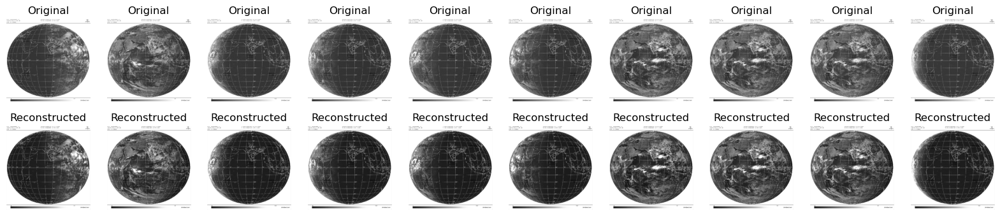

In [11]:
import matplotlib.pyplot as plt

# Generate reconstructed images from the test dataset
decoded_imgs = autoencoder.predict(x_test)

# Function to plot original and reconstructed images
def plot_images(original, reconstructed, n=10):
    plt.figure(figsize=(20, 4))
    
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original[i].reshape(512, 512), cmap='gray')
        plt.title("Original")
        plt.axis('off')

        # Display reconstructed images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed[i].reshape(512, 512), cmap='gray')
        plt.title("Reconstructed")
        plt.axis('off')

    plt.show()

# Plot the images
plot_images(x_test, decoded_imgs)

x_train1 shape: (59, 512, 512, 1)
x_train2 shape: (59, 512, 512, 1)
Epoch 1/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 31s 6s/step - loss: 0.6935 - val_loss: 0.6866
Epoch 2/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 25s 6s/step - loss: 0.6859 - val_loss: 0.6758
Epoch 3/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 23s 5s/step - loss: 0.6749 - val_loss: 0.6588
Epoch 4/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 28s 6s/step - loss: 0.6579 - val_loss: 0.6381
Epoch 5/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 38s 6s/step - loss: 0.6374 - val_loss: 0.6149
Epoch 6/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 31s 6s/step - loss: 0.6149 - val_loss: 0.6011
Epoch 7/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 31s 6s/step - loss: 0.6012 - val_loss: 0.5862
Epoch 8/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 39s 7s/step - loss: 0.5845 - val_loss: 0.5683
Epoch 9/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 59s 7s/step - loss: 0.5639 - val_loss: 0.5395
Epoch 10/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 64s 7s/step - loss: 0.5337 - val_loss: 0.5136
Epoch 11/50
2/2 ━━━━━━━━━━━━━━━━━━━━ 53s 7s/step - loss: 0.5064 - val_loss: 0.4874
Epoch 12/50
2/2 ━━━━━━━━━━━━

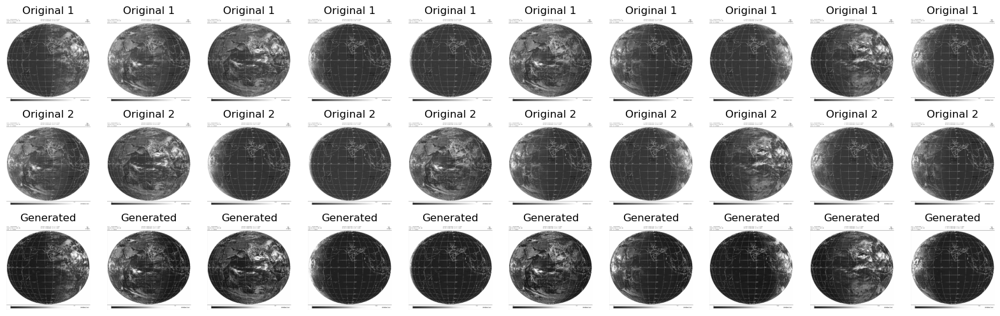

In [17]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt

# Function to load images from a directory
def load_images_from_directory(directory, target_size=(512, 512)):
    images = []
    for filename in os.listdir(directory):
        if filename.endswith('.jpg') or filename.endswith('.png'):  # Add other formats if needed
            img_path = os.path.join(directory, filename)
            img = load_img(img_path, target_size=target_size, color_mode='grayscale')  # Load as grayscale
            img_array = img_to_array(img)
            images.append(img_array)
    return np.array(images)

# Load all images from the directory
image_directory = 'Dataset/'
all_images = load_images_from_directory(image_directory)

# Normalize the images
all_images = all_images.astype('float32') / 255.0

# Create pairs of consecutive images
pairs = []
for i in range(len(all_images) - 1):
    pairs.append((all_images[i], all_images[i + 1]))

# Convert pairs to numpy arrays
x_train1 = np.array([pair[0] for pair in pairs])
x_train2 = np.array([pair[1] for pair in pairs])

# Set image dimensions
image_shape = (512, 512, 1)

# Reshape the data to match the expected input shape if necessary
x_train1 = np.reshape(x_train1, (-1, *image_shape))
x_train2 = np.reshape(x_train2, (-1, *image_shape))

# Print the dataset shapes
print(f"x_train1 shape: {x_train1.shape}")
print(f"x_train2 shape: {x_train2.shape}")

# Encoder
input_img1 = Input(shape=image_shape)
input_img2 = Input(shape=image_shape)

# Encoder for the first image
x1 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img1)
x1 = Conv2D(16, (3, 3), activation='relu', padding='same')(x1)
feature_map1 = Conv2D(8, (3, 3), activation='relu', padding='same')(x1)

# Encoder for the second image
x2 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img2)
x2 = Conv2D(16, (3, 3), activation='relu', padding='same')(x2)
feature_map2 = Conv2D(8, (3, 3), activation='relu', padding='same')(x2)

# Combine the two feature maps
combined_feature_map = Concatenate(axis=-1)([feature_map1, feature_map2])

# Decoder
x = Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(combined_feature_map)
x = Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2DTranspose(1, (3, 3), activation='sigmoid', padding='same')(x)

# Autoencoder model
autoencoder = Model([input_img1, input_img2], decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

# Train the autoencoder
autoencoder.fit([x_train1, x_train2], x_train1, epochs=50, validation_split=0.2)

# Generate new images between the pairs of images
generated_images = autoencoder.predict([x_train1, x_train2])

# Function to visualize the generated images
"""def plot_generated_images(original1, original2, generated, n=10):
    plt.figure(figsize=(20, 6))
    
    for i in range(n):
        # Display original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original1[i].reshape(512, 512), cmap='gray')
        plt.title("Original 1")
        plt.axis('off')

        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(original2[i].reshape(512, 512), cmap='gray')
        plt.title("Original 2")
        plt.axis('off')

        # Display generated images
        ax = plt.subplot(3, n, i + 1 + 2*n)
        plt.imshow(generated[i].reshape(512, 512), cmap='gray')
        plt.title("Generated")
        plt.axis('off')

    plt.show()
"""
plt.figure(figsize=(20,6))
plt.imshow(generated[2].reshape(512,512), cmap = 'gray')
plt.axis("off")
# Visualize the generated images
plot_generated_images(x_train1, x_train2, generated_images)

(-0.5, 511.5, 511.5, -0.5)

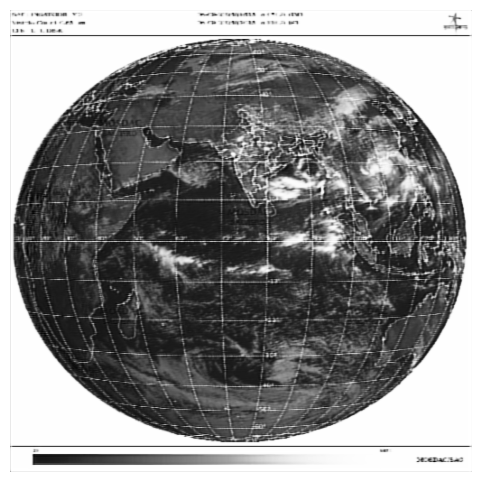

In [21]:
plt.figure(figsize=(20,6))
plt.imshow(generated_images[2].reshape(512,512), cmap = 'gray')
plt.axis("off")

In [2]:
import cv2
import numpy as np
import os

def resize_image(image, target_size=(512, 512)):
    return cv2.resize(image, target_size, interpolation=cv2.INTER_LINEAR)

def apply_cloud_mask(image, mask):
    if len(image.shape) == 3 and image.shape[2] == 3:  # RGB image
        mask = np.expand_dims(mask, axis=-1)  # Add a channel dimension to the mask
        mask = np.repeat(mask, 3, axis=-1)  # Repeat the mask across the RGB channels
    elif len(image.shape) == 2:  # Grayscale image
        mask = np.expand_dims(mask, axis=-1)  # Add a channel dimension to the mask

    return image * (mask / 255.0)

def process_images_with_cloud_mask(image_directory, target_size=(512, 512)):
    cloud_masks = []
    masked_images = []

    # Create a directory for masked images
    masked_image_directory = 'MaskedImages/'
    os.makedirs(masked_image_directory, exist_ok=True)
    
    for filename in os.listdir(image_directory):
        if filename.endswith('.jpg') or filename.endswith('.png'):
            img_path = os.path.join(image_directory, filename)
            
            # Read and preprocess image
            img = cv2.imread(img_path)
            img = resize_image(img, target_size)  # Resize image
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            _, mask = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)
            
            # Resize mask to match the image size
            mask = resize_image(mask, target_size)
            
            # Save cloud mask
            mask_path = os.path.join(masked_image_directory, 'mask_' + filename)
            cv2.imwrite(mask_path, mask)
            
            # Apply mask to the image
            masked_img = apply_cloud_mask(img, mask)
            masked_img_path = os.path.join(masked_image_directory, 'masked_' + filename)
            cv2.imwrite(masked_img_path, masked_img)
            
            cloud_masks.append(mask)
            masked_images.append(masked_img)

    return np.array(masked_images), np.array(cloud_masks)

# Directory containing images
image_directory = 'updated_images/updated_images'
masked_images, cloud_masks = process_images_with_cloud_mask(image_directory)

# Convert to float32 and normalize
masked_images = masked_images.astype('float32') / 255.0


In [3]:
# Create pairs of masked images
x_train1, x_train2 = create_image_pairs(masked_images)

# Placeholder for wind data (replace with actual data)
wind_data = np.random.rand(len(x_train1), 512, 512, 2)  # Dummy wind data

# Check shapes
print(f"x_train1 shape: {x_train1.shape}")
print(f"x_train2 shape: {x_train2.shape}")
print(f"wind_data shape: {wind_data.shape}")

# Ensure all inputs to the model have the correct shape
assert x_train1.shape[1:] == (512, 512, 3), "Shape mismatch for x_train1"
assert x_train2.shape[1:] == (512, 512, 3), "Shape mismatch for x_train2"
assert wind_data.shape[1:] == (512, 512, 2), "Shape mismatch for wind_data"


x_train1 shape: (407, 512, 512, 3)
x_train2 shape: (407, 512, 512, 3)
wind_data shape: (407, 512, 512, 2)


In [5]:
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model

# Function to load pairs of images
def create_image_pairs(images):
    pairs = []
    for i in range(len(images) - 1):
        pairs.append((images[i], images[i + 1]))
    return np.array([pair[0] for pair in pairs]), np.array([pair[1] for pair in pairs])

# Create pairs of masked images
x_train1, x_train2 = create_image_pairs(masked_images)

# Placeholder for wind data (replace with actual data)
wind_data = np.random.rand(len(x_train1), 512, 512, 2)  # Dummy wind data

# Set image dimensions
image_shape = (512, 512, 3)  # 3 channels for RGB images

# Encoder
input_img1 = Input(shape=image_shape)
input_img2 = Input(shape=image_shape)
input_wind = Input(shape=(512, 512, 2))

# Encoder for the first image
x1 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img1)
x1 = Conv2D(16, (3, 3), activation='relu', padding='same')(x1)
feature_map1 = Conv2D(8, (3, 3), activation='relu', padding='same')(x1)

# Encoder for the second image
x2 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img2)
x2 = Conv2D(16, (3, 3), activation='relu', padding='same')(x2)
feature_map2 = Conv2D(8, (3, 3), activation='relu', padding='same')(x2)

# Encoder for wind data
x_wind = Conv2D(16, (3, 3), activation='relu', padding='same')(input_wind)
x_wind = Conv2D(8, (3, 3), activation='relu', padding='same')(x_wind)

# Combine the three feature maps
combined_feature_map = Concatenate(axis=-1)([feature_map1, feature_map2, x_wind])

# Decoder
x = Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(combined_feature_map)
x = Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(x)
decoded = Conv2DTranspose(3, (3, 3), activation='sigmoid', padding='same')(x)  # RGB output

# Autoencoder model
autoencoder = Model([input_img1, input_img2, input_wind], decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

# Train the autoencoder
autoencoder.fit([x_train1, x_train2, wind_data], x_train1, epochs=50, validation_split=0.2,batch_size=8)

# Generate new images between the pairs of images
generated_images = autoencoder.predict([x_train1, x_train2, wind_data])

# Function to visualize the generated images
def plot_generated_images(original1, original2, generated, n=10):
    plt.figure(figsize=(20, 6))
    
    for i in range(n):
        # Display original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original1[i])
        plt.title("Original 1")
        plt.axis('off')

        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(original2[i])
        plt.title("Original 2")
        plt.axis('off')

        # Display generated images
        ax = plt.subplot(3, n, i + 1 + 2*n)
        plt.imshow(generated[i])
        plt.title("Generated")
        plt.axis('off')

    plt.show()

# Visualize the generated images
plot_generated_images(x_train1, x_train2, generated_images)


Epoch 1/50
41/41 [==============================] - 142s 3s/step - loss: 0.3783 - val_loss: 0.1679
Epoch 2/50
41/41 [==============================] - 130s 3s/step - loss: 0.1679 - val_loss: 0.1232
Epoch 3/50
41/41 [==============================] - 126s 3s/step - loss: 0.1178 - val_loss: 0.0820
Epoch 4/50
41/41 [==============================] - 126s 3s/step - loss: 0.0801 - val_loss: 0.0619
Epoch 5/50
41/41 [==============================] - 125s 3s/step - loss: 0.0677 - val_loss: 0.0582
Epoch 6/50
41/41 [==============================] - 125s 3s/step - loss: 0.0658 - val_loss: 0.0576
Epoch 7/50
41/41 [==============================] - 125s 3s/step - loss: 0.0648 - val_loss: 0.0567
Epoch 8/50
41/41 [==============================] - 126s 3s/step - loss: 0.0639 - val_loss: 0.0561
Epoch 9/50
41/41 [==============================] - 125s 3s/step - loss: 0.0630 - val_loss: 0.0554
Epoch 10/50
41/41 [==============================] - 126s 3s/step - loss: 0.0625 - val_loss: 0.0552
Epoch 11/

: 

In [7]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, Concatenate, Dropout
from tensorflow.keras.models import Model

# Function to load images from a directory
def load_images_from_directory(directory, target_size=(512, 512)):
    images = []
    for filename in os.listdir(directory):
        if filename.endswith('.jpg') or filename.endswith('.png'):
            img_path = os.path.join(directory, filename)
            img = load_img(img_path, target_size=target_size, color_mode='grayscale')
            img_array = img_to_array(img)
            images.append(img_array)
    return np.array(images)

# Load all images from the directory
image_directory = 'MaskedImages/'
all_images = load_images_from_directory(image_directory)

# Normalize the images
all_images = all_images.astype('float32') / 255.0

# Create pairs of consecutive images
pairs = []
for i in range(len(all_images) - 1):
    pairs.append((all_images[i], all_images[i + 1]))

# Convert pairs to numpy arrays
x_train1 = np.array([pair[0] for pair in pairs])
x_train2 = np.array([pair[1] for pair in pairs])

# Set image dimensions
image_shape = (512, 512, 1)

# Reshape the data to match the expected input shape if necessary
x_train1 = np.reshape(x_train1, (-1, *image_shape))
x_train2 = np.reshape(x_train2, (-1, *image_shape))

# Load and preprocess wind data
x_wind_array = np.load('arrow_info_array.npy')
x_wind_array = tf.image.resize(x_wind_array, (512, 512))  # Resize to (256, 256, 1)
x_wind_array = tf.image.rgb_to_grayscale(x_wind_array)  # Convert to grayscale
x_train_wind = np.tile(x_wind_array, (len(x_train1), 1, 1, 1))  # Repeat for each image pair

# Encoder
input_img1 = Input(shape=image_shape)
input_img2 = Input(shape=image_shape)
input_wind = Input(shape=(512, 512, 1))

def encoder_block(input_layer):
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(input_layer)
    x = Dropout(0.2)(x)  # Adding dropout
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    return x

encoded1 = encoder_block(input_img1)
encoded2 = encoder_block(input_img2)
encoded_wind = encoder_block(input_wind)

# Combine the three feature maps
combined_encoded = Concatenate()([encoded1, encoded2, encoded_wind])

# Decoder
def decoder_block(input_layer):
    x = Conv2DTranspose(32, (3, 3), activation='relu', padding='same')(input_layer)
    x = Dropout(0.2)(x)  # Adding dropout
    x = Conv2DTranspose(16, (3, 3), activation='relu', padding='same')(x)
    return x

x = decoder_block(combined_encoded)
decoded = Conv2DTranspose(1, (3, 3), activation='sigmoid', padding='same')(x)

# Autoencoder model
autoencoder = Model([input_img1, input_img2, input_wind], decoded)
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')

# Train the model
autoencoder.fit([x_train1, x_train2, x_train_wind], x_train1, epochs=50, batch_size=16, validation_split=0.2)

# Optional: Save the model
# autoencoder.save('frame_interpolation_autoencoder.h5')

Epoch 1/50
41/41 [==============================] - 277s 7s/step - loss: 0.4141 - val_loss: 0.1275
Epoch 2/50
41/41 [==============================] - 268s 7s/step - loss: 0.1095 - val_loss: 0.0247
Epoch 3/50
41/41 [==============================] - 268s 7s/step - loss: 0.0757 - val_loss: 0.0200
Epoch 4/50
41/41 [==============================] - 270s 7s/step - loss: 0.0731 - val_loss: 0.0197
Epoch 5/50
41/41 [==============================] - 270s 7s/step - loss: 0.0722 - val_loss: 0.0219
Epoch 6/50
41/41 [==============================] - 269s 7s/step - loss: 0.0717 - val_loss: 0.0223
Epoch 7/50
41/41 [==============================] - 268s 7s/step - loss: 0.0713 - val_loss: 0.0203
Epoch 8/50
41/41 [==============================] - 269s 7s/step - loss: 0.0707 - val_loss: 0.0193
Epoch 9/50
41/41 [==============================] - 268s 7s/step - loss: 0.0703 - val_loss: 0.0181
Epoch 10/50
41/41 [==============================] - 267s 7s/step - loss: 0.0701 - val_loss: 0.0185
Epoch 11/

In [9]:
import os
import matplotlib.pyplot as plt

# Create a directory to save generated images if it doesn't exist
output_directory = 'GeneratedImages/'
os.makedirs(output_directory, exist_ok=True)

# Function to save generated images
def save_generated_images(model, x_train1, x_train2, x_wind, output_dir):
    # Generate images using the trained model
    generated_images = model.predict([x_train1, x_train2, x_wind])
    
    # Save each generated image
    for i in range(len(generated_images)):
        # Convert the generated image from tensor to array and scale back to [0, 255]
        img = (generated_images[i] * 255).astype(np.uint8).squeeze()  # Squeeze to remove single-dimensional entries
        
        # Save the image
        img_filename = os.path.join(output_dir, f'generated_image_{i + 1}.png')
        plt.imsave(img_filename, img, cmap='gray')  # Save as grayscale image

# Call the function to save generated images
save_generated_images(autoencoder, x_train1, x_train2, x_train_wind, output_directory)

print(f"Generated images saved to {output_directory}")

26/26 [==============================] - 98s 4s/step
Generated images saved to GeneratedImages/


In [12]:
# Optional: Save the model
autoencoder.save('frame_interpolation_autoencoder.h5')

In [14]:
# Optional: Save the model
autoencoder.save('frame_interpolation_autoencoder.keras')

In [15]:
autoencoder.save('frame_interpolation_autoencoder')

INFO:tensorflow:Assets written to: frame_interpolation_autoencoder\assets


INFO:tensorflow:Assets written to: frame_interpolation_autoencoder\assets


In [7]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

In [ ]:
# Load images
def load_image(path):
    return np.array(Image.open(path).convert('L')) / 255.0

# Visualization function
def visualize_comparison(input1_path, input2_path, generated_path, ground_truth_path=None):
    input1 = load_image(input1_path)
    input2 = load_image(input2_path)
    generated = load_image(generated_path)
    
    plt.figure(figsize=(20, 5))
    
    # Input image 1
    plt.subplot(1, 4, 1)
    plt.imshow(input1, cmap='gray')
    plt.title("Input Image 1")
    plt.axis('off')
    
    # Generated image
    plt.subplot(1, 4, 2)
    plt.imshow(generated, cmap='gray')
    plt.title("Generated Image")
    plt.axis('off')
    
    # Ground truth (if available)
    if ground_truth_path:
        ground_truth = load_image(ground_truth_path)
        plt.subplot(1, 4, 3)
        plt.imshow(ground_truth, cmap='gray')
        plt.title("Ground Truth")
        plt.axis('off')
    
    # Input image 2
    plt.subplot(1, 4, 4)
    plt.imshow(input2, cmap='gray')
    plt.title("Input Image 2")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage (modify paths as needed)
input1 = "/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/MaskedImages/mask_3RIMG_01AUG2024_0015_L1C_ASIA_MER_BT_IR1_TEMP_V01R00.jpg"  # Replace with actual path
input2 = "/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/MaskedImages/mask_3RIMG_01AUG2024_0115_L1C_ASIA_MER_BT_IR1_TEMP_V01R00.jpg"  # Replace with actual path
generated = "/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/GeneratedImages/generated_image_1.png"  # Replace with actual path
ground_truth = "/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/MaskedImages/mask_3RIMG_01AUG2024_0045_L1C_ASIA_MER_BT_IR1_TEMP_V01R00.jpg"  # If available

visualize_comparison(input1, input2, generated, ground_truth)

NameError: name 'history' is not defined

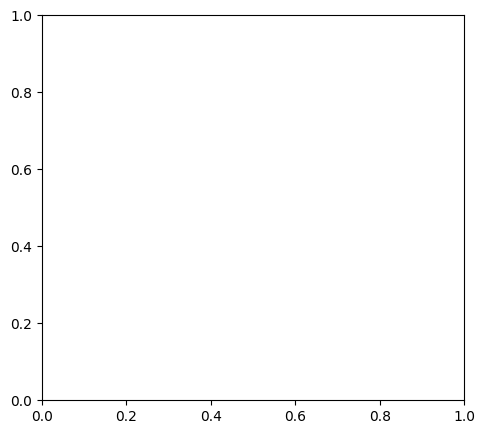

In [24]:
# Plot training history
plt.figure(figsize=(12, 5))

# Loss curves
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Timing metrics
plt.subplot(1, 2, 2)
metrics = {
    'Training Time': history.history.get('training_time', [training_time])[0],
    'Avg Time/Epoch': training_time/len(history.history['loss']),
    'Frame Gen Time': gen_time,
    'Frames Generated': len(x_train1)
}
plt.bar(metrics.keys(), metrics.values(), color=['blue', 'green', 'red', 'purple'])
plt.title('Performance Metrics')
plt.ylabel('Seconds/Count')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import time
from tensorflow.keras.models import load_model

# 1. Load your trained model from .h5 file
model = load_model('frame_interpolation_autoencoder.h5')

# 2. Time frame generation function
def time_frame_generation(model, input1, input2, wind_data, n_runs=5):
    times = []
    for _ in range(n_runs):
        start = time.time()
        model.predict([input1, input2, wind_data])
        times.append(time.time() - start)
    return np.mean(times), np.std(times)

# 3. Prepare sample data (replace with your actual data)
# Using smaller 256x256 inputs since your .h5 model may expect this size
sample_input1 = np.random.rand(1, 256, 256, 1)  # Replace with actual x_train1[0:1]
sample_input2 = np.random.rand(1, 256, 256, 1)  # Replace with actual x_train2[0:1] 
sample_wind = np.random.rand(1, 256, 256, 1)    # Replace with actual x_train_wind[0:1]

# 4. Get timing metrics
avg_time, std_time = time_frame_generation(model, sample_input1, sample_input2, sample_wind)

# 5. Create visualizations
plt.figure(figsize=(12, 5))

# Timing plot
plt.subplot(1, 2, 1)
plt.bar(['Frame Generation'], [avg_time], yerr=[std_time], capsize=10, color='orange')
plt.ylabel('Time (seconds)')
plt.title('Generation Performance (H5 Model)')

# Sample output visualization
plt.subplot(1, 2, 2)
generated = model.predict([sample_input1, sample_input2, sample_wind])[0]
plt.imshow(generated.squeeze(), cmap='gray')
plt.title('Generated Frame Sample')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"Performance Metrics:")
print(f"Average generation time: {avg_time:.4f} seconds")
print(f"Standard deviation: {std_time:.4f} seconds")
print(f"FPS: {1/avg_time:.2f} frames per second")

TypeError: Error when deserializing class 'Conv2DTranspose' using config={'name': 'conv2d_transpose_6', 'trainable': True, 'dtype': 'float32', 'filters': 32, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None, 'output_padding': None}.

Exception encountered: Unrecognized keyword arguments passed to Conv2DTranspose: {'groups': 1}

In [25]:
diffs = [np.mean(np.abs(generated_images[i] - generated_images[i+1])) 
         for i in range(len(generated_images)-1)]

plt.figure(figsize=(10, 4))
plt.plot(diffs, marker='o')
plt.axhline(y=np.mean(diffs), color='r', linestyle='--', label=f'Mean: {np.mean(diffs):.4f}')
plt.xlabel('Frame Pair Index')
plt.ylabel('Absolute Difference')
plt.title('Temporal Consistency Between Generated Frames')
plt.legend()
plt.grid(True)
plt.show()

NameError: name 'generated_images' is not defined

Skipping set 0 due to missing files.


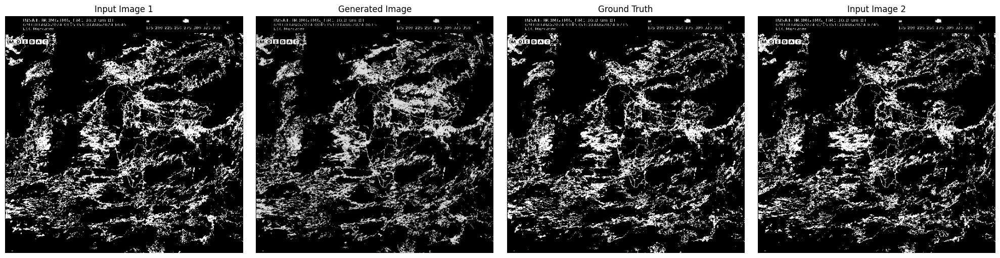

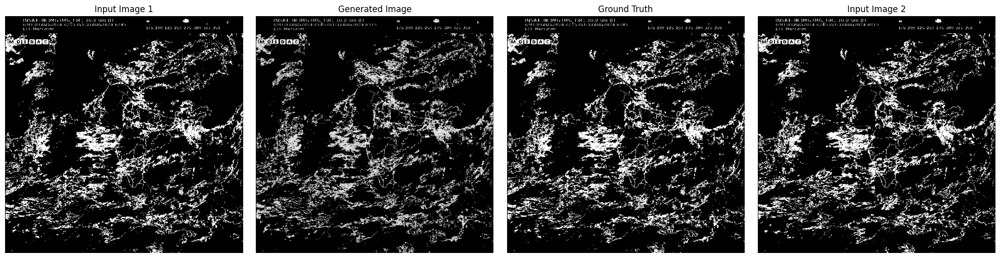

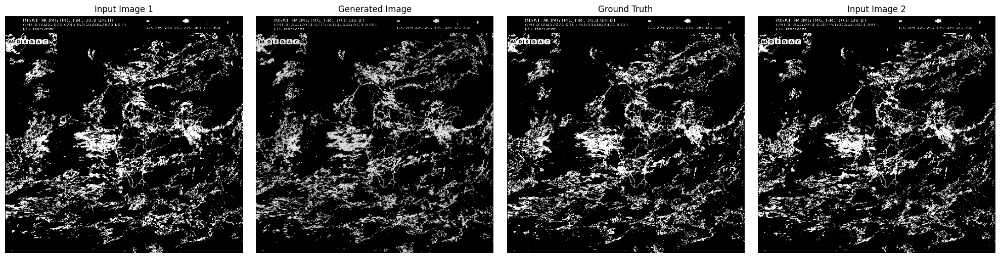

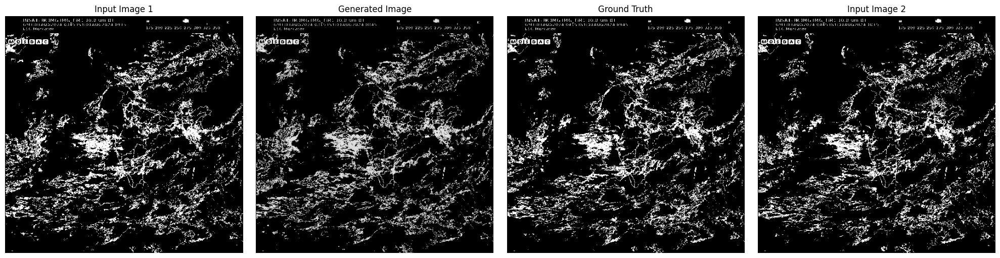

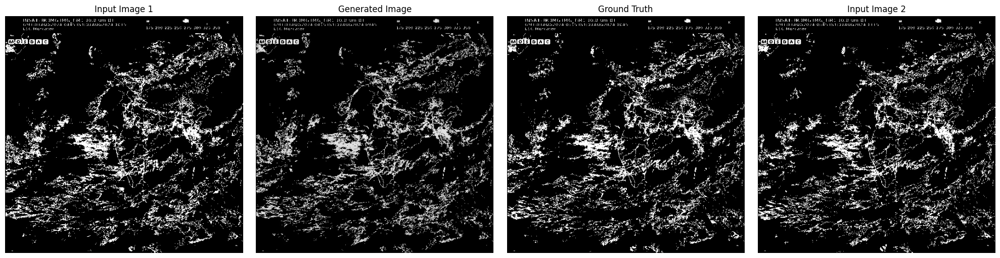

...

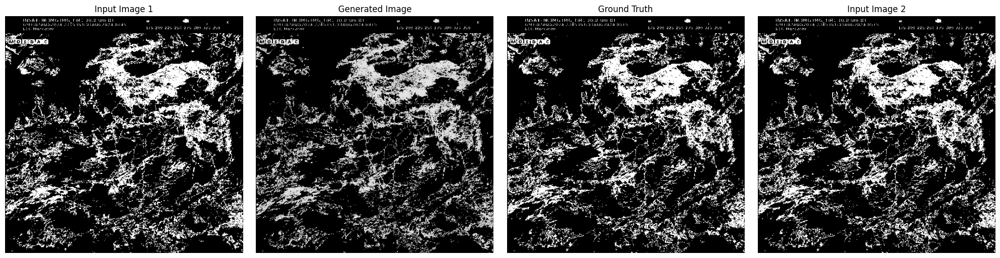

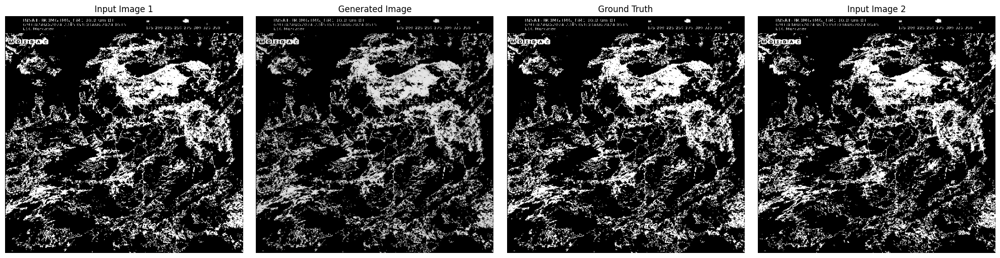

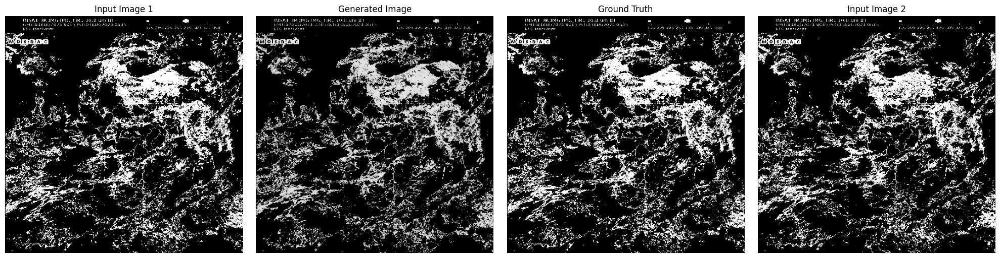

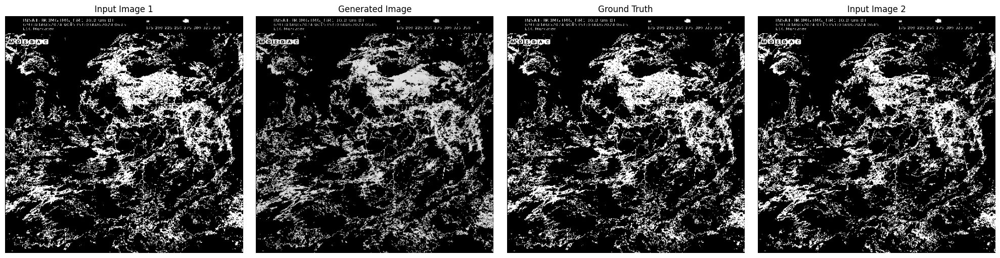

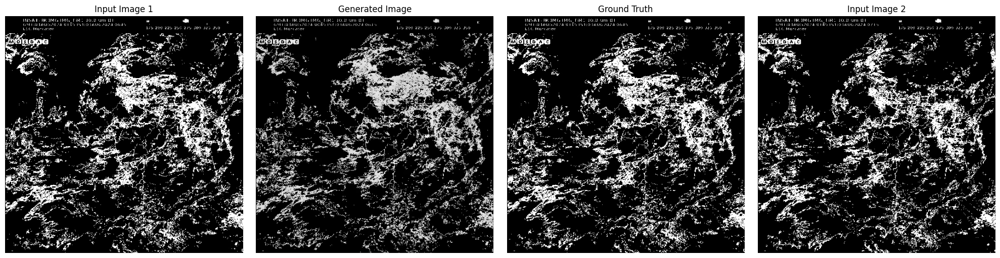

In [12]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def load_image(path):
    return np.array(Image.open(path).convert('L')) / 255.0

def visualize_comparison(input1_path, input2_path, generated_path, ground_truth_path=None):
    input1 = load_image(input1_path)
    input2 = load_image(input2_path)
    generated = load_image(generated_path)
    
    plt.figure(figsize=(20, 5))

    plt.subplot(1, 4, 1)
    plt.imshow(input1, cmap='gray')
    plt.title("Input Image 1")
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.imshow(generated, cmap='gray')
    plt.title("Generated Image")
    plt.axis('off')

    if ground_truth_path:
        ground_truth = load_image(ground_truth_path)
        plt.subplot(1, 4, 3)
        plt.imshow(ground_truth, cmap='gray')
        plt.title("Ground Truth")
        plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.imshow(input2, cmap='gray')
    plt.title("Input Image 2")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Directories
masked_images_dir = "/Users/vaibhavagarwal/Desktop/yash/sem5/sih24/Bhot-sih-liya-main/MaskedImages"
generated_images_dir = "/Users/vaibhavagarwal/Desktop/yash/sem5/sih24/Bhot-sih-liya-main/GeneratedImages"

# Get and sort all masked image filenames
masked_images = sorted([
    f for f in os.listdir(masked_images_dir)
    if f.endswith(".jpg") and "mask_3RIMG" in f
])

# Loop through the images in steps of 2 to get input1, input2, and mid one as ground truth
for i in range(0, min(len(masked_images) - 2, 100), 2):  # visualize up to 50 sets
    input1_path = os.path.join(masked_images_dir, masked_images[i])
    input2_path = os.path.join(masked_images_dir, masked_images[i + 2])
    ground_truth_path = os.path.join(masked_images_dir, masked_images[i + 1])
    
    generated_path = os.path.join(generated_images_dir, f"generated_image_{i}.png")

    if all(os.path.exists(p) for p in [input1_path, input2_path, ground_truth_path, generated_path]):
        visualize_comparison(input1_path, input2_path, generated_path, ground_truth_path)
    else:
        print(f"Skipping set {i} due to missing files.")


In [ ]:

# Load images
def load_image(path):
    return np.array(Image.open(path).convert('L')) / 255.0

# Visualization function
def visualize_comparison(input1_path, input2_path, generated_path, ground_truth_path=None):
    input1 = load_image(input1_path)
    input2 = load_image(input2_path)
    generated = load_image(generated_path)
    
    plt.figure(figsize=(20, 5))
    
    # Input image 1
    plt.subplot(1, 4, 1)
    plt.imshow(input1, cmap='gray')
    plt.title("Input Image 1")
    plt.axis('off')
    
    # Generated image
    plt.subplot(1, 4, 2)
    plt.imshow(generated, cmap='gray')
    plt.title("Generated Image")
    plt.axis('off')
    
    # Ground truth (if available)
    if ground_truth_path:
        ground_truth = load_image(ground_truth_path)
        plt.subplot(1, 4, 3)
        plt.imshow(ground_truth, cmap='gray')
        plt.title("Ground Truth")
        plt.axis('off')
    
    # Input image 2
    plt.subplot(1, 4, 4)
    plt.imshow(input2, cmap='gray')
    plt.title("Input Image 2")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage (modify paths as needed)
input1 = "MaskedImages/masked_image1.png"  # Replace with actual path
input2 = "MaskedImages/masked_image2.png"  # Replace with actual path
generated = "GeneratedImages/generated_image_1.png"  # Replace with actual path
ground_truth = "Dataset/middle_frame.png"  # If available

visualize_comparison(input1, input2, generated, ground_truth)

FileNotFoundError: [Errno 2] No such file or directory: 'MaskedImages/masked_image1.png'

In [ ]:

# Load images
def load_image(path):
    return np.array(Image.open(path).convert('L')) / 255.0

# Visualization function
def visualize_comparison(input1_path, input2_path, generated_path, ground_truth_path=None):
    input1 = load_image(input1_path)
    input2 = load_image(input2_path)
    generated = load_image(generated_path)
    
    plt.figure(figsize=(20, 5))
    
    # Input image 1
    plt.subplot(1, 4, 1)
    plt.imshow(input1, cmap='gray')
    plt.title("Input Image 1")
    plt.axis('off')
    
    # Generated image
    plt.subplot(1, 4, 2)
    plt.imshow(generated, cmap='gray')
    plt.title("Generated Image")
    plt.axis('off')
    
    # Ground truth (if available)
    if ground_truth_path:
        ground_truth = load_image(ground_truth_path)
        plt.subplot(1, 4, 3)
        plt.imshow(ground_truth, cmap='gray')
        plt.title("Ground Truth")
        plt.axis('off')
    
    # Input image 2
    plt.subplot(1, 4, 4)
    plt.imshow(input2, cmap='gray')
    plt.title("Input Image 2")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage (modify paths as needed)
input1 = "MaskedImages/masked_image1.png"  # Replace with actual path
input2 = "MaskedImages/masked_image2.png"  # Replace with actual path
generated = "GeneratedImages/generated_image_1.png"  # Replace with actual path
ground_truth = "Dataset/middle_frame.png"  # If available

visualize_comparison(input1, input2, generated, ground_truth)

FileNotFoundError: [Errno 2] No such file or directory: 'MaskedImages/masked_image1.png'

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from PIL import Image

In [11]:
from keras.models import load_model

ModuleNotFoundError: No module named 'keras'

In [12]:
pip install tensorflow numpy pillow matplotlib

  Using cached astunparse-1.6.3-py2.py3-none-any.whl.metadata (4.4 kB)
  Using cached flatbuffers-25.2.10-py2.py3-none-any.whl.metadata (875 bytes)
  Using cached gast-0.6.0-py3-none-any.whl.metadata (1.3 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl.metadata (814 bytes)
  Using cached libclang-18.1.1-1-py2.py3-none-macosx_11_0_arm64.whl.metadata (5.2 kB)
  Using cached opt_einsum-3.4.0-py3-none-any.whl.metadata (6.3 kB)
  Using cached tensorboard-2.19.0-py3-none-any.whl.metadata (1.8 kB)
  Using cached numpy-2.1.3-cp311-cp311-macosx_14_0_arm64.whl.metadata (62 kB)
  Using cached wheel-0.45.1-py3-none-any.whl.metadata (2.3 kB)
  Using cached namex-0.0.8-py3-none-any.whl.metadata (246 bytes)
  Using cached Markdown-3.7-py3-none-any.whl.metadata (7.0 kB)
  Using cached tensorboard_data_server-0.7.2-py3-none-any.whl.metadata (1.1 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 252.6/252.6 MB 1.2 MB/s eta 0:00:0000:0100:06
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.0/14.0 MB 1

In [18]:
pip uninstall tensorflow keras -y
pip install tensorflow==2.10.0 numpy==1.23.5

SyntaxError: invalid syntax (2515440780.py, line 1)

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from PIL import Image
import os

In [17]:

# Load saved model
model = load_model('/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/frame_interpolation_autoencoder.keras')

# Load and preprocess input images
def load_image(path):
    img = Image.open(path).convert('L')
    return np.array(img) / 255.0

# Example paths - replace with your actual image paths
 # Second input frame
input1_path = "/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/MaskedImages/mask_3RIMG_01AUG2024_0015_L1C_ASIA_MER_BT_IR1_TEMP_V01R00.jpg"  # Replace with actual path
input2_path = "/Users/vaibhavagarwal/Downloads/Bhot-sih-liya-main/MaskedImages/mask_3RIMG_01AUG2024_0115_L1C_ASIA_MER_BT_IR1_TEMP_V01R00.jpg"  # Replace with actual path


# Load and prepare images
img1 = load_image(input1_path).reshape(1, 256, 256, 1)  # Adjust dimensions as needed
img2 = load_image(input2_path).reshape(1, 256, 256, 1)

# Generate intermediate frame
generated = model.predict([img1, img2])[0]

# Visualize results
plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.imshow(img1[0,:,:,0], cmap='gray')
plt.title('Input Frame 1')
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(generated[:,:,0], cmap='gray')
plt.title('Generated Frame')
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(img2[0,:,:,0], cmap='gray')
plt.title('Input Frame 2')
plt.axis('off')

plt.tight_layout()
plt.show()

# Save generated image
output_path = 'GeneratedImages/generated_frame.png'
plt.imsave(output_path, generated[:,:,0], cmap='gray')
print(f"Generated frame saved to {output_path}")

TypeError: Could not deserialize class 'Functional' because its parent module keras.src.engine.functional cannot be imported. Full object config: {'module': 'keras.src.engine.functional', 'class_name': 'Functional', 'config': {'name': 'model_2', 'trainable': True, 'layers': [{'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_input_shape': [None, 512, 512, 1], 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'input_10'}, 'registered_name': None, 'name': 'input_10', 'inbound_nodes': []}, {'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_input_shape': [None, 512, 512, 1], 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'input_11'}, 'registered_name': None, 'name': 'input_11', 'inbound_nodes': []}, {'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_input_shape': [None, 512, 512, 1], 'dtype': 'float32', 'sparse': False, 'ragged': False, 'name': 'input_12'}, 'registered_name': None, 'name': 'input_12', 'inbound_nodes': []}, {'module': 'keras.layers', 'class_name': 'Conv2D', 'config': {'name': 'conv2d_18', 'trainable': True, 'dtype': 'float32', 'filters': 16, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 1]}, 'name': 'conv2d_18', 'inbound_nodes': [[['input_10', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2D', 'config': {'name': 'conv2d_20', 'trainable': True, 'dtype': 'float32', 'filters': 16, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 1]}, 'name': 'conv2d_20', 'inbound_nodes': [[['input_11', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2D', 'config': {'name': 'conv2d_22', 'trainable': True, 'dtype': 'float32', 'filters': 16, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 1]}, 'name': 'conv2d_22', 'inbound_nodes': [[['input_12', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Dropout', 'config': {'name': 'dropout_11', 'trainable': True, 'dtype': 'float32', 'rate': 0.2, 'noise_shape': None, 'seed': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'dropout_11', 'inbound_nodes': [[['conv2d_18', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Dropout', 'config': {'name': 'dropout_12', 'trainable': True, 'dtype': 'float32', 'rate': 0.2, 'noise_shape': None, 'seed': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'dropout_12', 'inbound_nodes': [[['conv2d_20', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Dropout', 'config': {'name': 'dropout_13', 'trainable': True, 'dtype': 'float32', 'rate': 0.2, 'noise_shape': None, 'seed': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'dropout_13', 'inbound_nodes': [[['conv2d_22', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2D', 'config': {'name': 'conv2d_19', 'trainable': True, 'dtype': 'float32', 'filters': 32, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'conv2d_19', 'inbound_nodes': [[['dropout_11', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2D', 'config': {'name': 'conv2d_21', 'trainable': True, 'dtype': 'float32', 'filters': 32, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'conv2d_21', 'inbound_nodes': [[['dropout_12', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2D', 'config': {'name': 'conv2d_23', 'trainable': True, 'dtype': 'float32', 'filters': 32, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'conv2d_23', 'inbound_nodes': [[['dropout_13', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Concatenate', 'config': {'name': 'concatenate_3', 'trainable': True, 'dtype': 'float32', 'axis': -1}, 'registered_name': None, 'build_config': {'input_shape': [[None, 512, 512, 32], [None, 512, 512, 32], [None, 512, 512, 32]]}, 'name': 'concatenate_3', 'inbound_nodes': [[['conv2d_19', 0, 0, {}], ['conv2d_21', 0, 0, {}], ['conv2d_23', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2DTranspose', 'config': {'name': 'conv2d_transpose_6', 'trainable': True, 'dtype': 'float32', 'filters': 32, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None, 'output_padding': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 96]}, 'name': 'conv2d_transpose_6', 'inbound_nodes': [[['concatenate_3', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Dropout', 'config': {'name': 'dropout_14', 'trainable': True, 'dtype': 'float32', 'rate': 0.2, 'noise_shape': None, 'seed': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 32]}, 'name': 'dropout_14', 'inbound_nodes': [[['conv2d_transpose_6', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2DTranspose', 'config': {'name': 'conv2d_transpose_7', 'trainable': True, 'dtype': 'float32', 'filters': 16, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'relu', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None, 'output_padding': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 32]}, 'name': 'conv2d_transpose_7', 'inbound_nodes': [[['dropout_14', 0, 0, {}]]]}, {'module': 'keras.layers', 'class_name': 'Conv2DTranspose', 'config': {'name': 'conv2d_transpose_8', 'trainable': True, 'dtype': 'float32', 'filters': 1, 'kernel_size': [3, 3], 'strides': [1, 1], 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': [1, 1], 'groups': 1, 'activation': 'sigmoid', 'use_bias': True, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None, 'output_padding': None}, 'registered_name': None, 'build_config': {'input_shape': [None, 512, 512, 16]}, 'name': 'conv2d_transpose_8', 'inbound_nodes': [[['conv2d_transpose_7', 0, 0, {}]]]}], 'input_layers': [['input_10', 0, 0], ['input_11', 0, 0], ['input_12', 0, 0]], 'output_layers': [['conv2d_transpose_8', 0, 0]]}, 'registered_name': 'Functional', 'build_config': {'input_shape': [[None, 512, 512, 1], [None, 512, 512, 1], [None, 512, 512, 1]]}, 'compile_config': {'optimizer': 'adam', 'loss': 'binary_crossentropy', 'metrics': None, 'loss_weights': None, 'weighted_metrics': None, 'run_eagerly': None, 'steps_per_execution': None, 'jit_compile': None}}